<a href="https://colab.research.google.com/github/IPeresypkina/AutoTestRolePlay/blob/master/Roboflow_Custom_Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# How to Train Detectron2 on Custom Objects

This tutorial implements the new [Detectron2 Library](https://ai.facebook.com/blog/-detectron2-a-pytorch-based-modular-object-detection-library-/) by facebook. This notebook shows training on **your own custom objects** for object detection.

It is worth noting that the Detectron2 library goes far beyond object detection, supporting semantic segmentation, keypoint detection, mask, and densepose.


### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train Detectron2](https://blog.roboflow.ai/how-to-train-detectron2/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train Detectron2 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install Detectron2 dependencies
* Download custom Detectron2 object detection data
* Visualize Detectron2 training data
* Write our Detectron2 Training configuration
* Run Detectron2 training
* Evaluate Detectron2 performance
* Run Detectron2 inference on test images



### **About**

[Roboflow](https://roboflow.ai) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

#### ![Roboflow Workmark](https://i.imgur.com/WHFqYSJ.png)

# Install Detectron2 Dependencies

In [1]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 22 kB/s 
     |████████████████████████████████| 6.6 MB 36.5 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.11.0+cu113
    Uninstalling torch-1.11.0+cu113:
      Successfully uninstalled torch-1.11.0+cu113
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.12.0+cu113
    Uninstalling torchvision-0.12.0+cu113:
      Successfully uninstalled torchvision-0.12.0+cu113
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.12.0 requires torch==1.11.0, but you have torch 1.5.0+cu101 which is incompatible.
torchaudio 0.11.0+cu113 requires torch==1.11.0, but you have torch 1.5.0+cu101

In [2]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 843 kB/s 
     |████████████████████████████████| 50 kB 5.5 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220512-py3-none-any.whl size=61288 sha256=3543fa1e777e8e56788e6d19922825ee53b8b7c1e1f021a9bc57e03ab1f6dc9a
  Stored in directory: /root/.cache/pip/wheels/68/20/f9/a11a0dd63f4c13678b2a5ec488e48078756505c7777b75b29e
Successfully built fvcore


In [3]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import and Register Custom Detectron2 Data

In [6]:
!curl -L "https://app.roboflow.com/ds/AvpAnBVA0M?key=kuiDsFFMj1" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   892  100   892    0     0   2703      0 --:--:-- --:--:-- --:--:--  2703
100 97.3M  100 97.3M    0     0  70.4M      0  0:00:01  0:00:01 --:--:--  137M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/Abyssinian_127_jpg.rf.dca571a8bce4fd13edd4c717c6b86cec.jpg  
 extracting: test/Abyssinian_131_jpg.rf.499fa2cb75e493536b170483facf9bb7.jpg  
 extracting: test/Abyssinian_149_jpg.rf.52c286a685917f2be8195e8643a38107.jpg  
 extracting: test/Abyssinian_155_jpg.rf.190f52ee8d1c0666a38122dc1de63e83.jpg  
 extracting: test/Abyssinian_15_jpg.rf.50d54b1ecd6fec6f61f28353e1228f21.jpg  
 extracting: test/Abyssinian_167_jpg.rf.836e9ee756de61e15a9da09dab7fc069.jpg  
 extracting: test/Abyssinian_174_jpg.rf.474a8a2f0da57a86e2484149d09b588c.jpg  
 extracting: t

In [9]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_datasets_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_datasets_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_datasets_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [06/17 10:53:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/17 10:53:30 d2.data.datasets.coco]: Loaded 2575 images in COCO format from /content/train/_annotations.coco.json


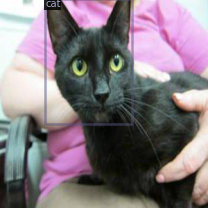

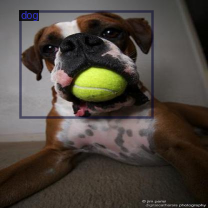

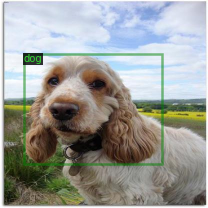

In [10]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("my_datasets_train")
dataset_dicts = DatasetCatalog.get("my_datasets_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# Train Custom Detectron2 Detector

In [11]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [19]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_datasets_train",)
cfg.DATASETS.TEST = ("my_datasets_val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001


cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2000 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (500, 1000, 1500, 2000)
cfg.SOLVER.GAMMA = 0.05




cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3 #your number of classes + 1

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[06/17 12:31:46 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/queues.py", line 242, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, buf)
BrokenPipeError: [Errno 32] Broken pipe
Traceback (most recent call last):
  File "/usr/lib/python3.7/multiprocessing/queues.py", line 242, in _feed
    send_bytes(obj)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 200, in send_bytes
    self._send_bytes(m[offset:offset + size])
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 404, in _send_bytes
    self._send(header + buf)
  File "/usr/lib/python3.7/multiprocessing/connection.py", line 368, in _send
    n = write(self._handle, b

[06/17 12:31:47 d2.engine.train_loop]: Starting training from iteration 0
[06/17 12:32:25 d2.utils.events]:  eta: 1:02:30  iter: 19  total_loss: 2.071  loss_cls: 1.291  loss_box_reg: 0.702  loss_rpn_cls: 0.047  loss_rpn_loc: 0.010  time: 1.9011  data_time: 0.0318  lr: 0.000020  max_mem: 8904M
[06/17 12:33:03 d2.utils.events]:  eta: 1:02:27  iter: 39  total_loss: 1.916  loss_cls: 1.018  loss_box_reg: 0.824  loss_rpn_cls: 0.028  loss_rpn_loc: 0.008  time: 1.9048  data_time: 0.0139  lr: 0.000040  max_mem: 8904M
[06/17 12:33:42 d2.utils.events]:  eta: 1:02:06  iter: 59  total_loss: 1.579  loss_cls: 0.695  loss_box_reg: 0.829  loss_rpn_cls: 0.035  loss_rpn_loc: 0.008  time: 1.9221  data_time: 0.0162  lr: 0.000060  max_mem: 8904M
[06/17 12:34:20 d2.utils.events]:  eta: 1:01:00  iter: 79  total_loss: 1.356  loss_cls: 0.523  loss_box_reg: 0.848  loss_rpn_cls: 0.022  loss_rpn_loc: 0.007  time: 1.9127  data_time: 0.0169  lr: 0.000080  max_mem: 8904M
[06/17 12:34:59 d2.utils.events]:  eta: 1:00:4

In [20]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

In [21]:
#test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [06/17 14:11:18 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[06/17 14:11:18 d2.data.datasets.coco]: Loaded 368 images in COCO format from /content/test/_annotations.coco.json
[06/17 14:11:18 d2.data.common]: Serializing 368 elements to byte tensors and concatenating them all ...
[06/17 14:11:18 d2.data.common]: Serialized dataset takes 0.10 MiB
[06/17 14:11:18 d2.evaluation.evaluator]: Start inference on 368 images
[06/17 14:11:20 d2.evaluation.evaluator]: Inference done 11/368. 0.1843 s / img. ETA=0:01:06
[06/17 14:11:26 d2.evaluation.evaluator]: Inference done 38/368. 0.1848 s / img. ETA=0:01:01
[06/17 14:11:31 d2.evaluation.evaluator]: Inference done 65/368. 0.1854 s / img. ETA=0:00:56
[06/17 14:11:36 d2.evaluation.evaluator]: Inference done 92/368. 0.1858 s / img. ETA=0:00:51
[06/17 14:11:41 d2.evaluation.evaluator]: Inference done 119/368. 0.1862 s / img. ETA=0:00:46
[06/17 14:11:46 d2.evaluation.evaluat

OrderedDict([('bbox',
              {'AP': 76.00114834913299,
               'AP-CatVsDog': nan,
               'AP-cat': 79.86755565833036,
               'AP-dog': 72.13474103993562,
               'AP50': 97.93829651565387,
               'AP75': 88.01737239135308,
               'APl': 77.68552161605609,
               'APm': 63.91896891592575,
               'APs': nan})])

# Inference with Detectron2 Saved Weights



In [22]:
%ls ./output/

coco_instances_results.json                       instances_predictions.pth
events.out.tfevents.1655463257.e864d94fa226.73.0  last_checkpoint
events.out.tfevents.1655464677.e864d94fa226.73.1  metrics.json
events.out.tfevents.1655469107.e864d94fa226.73.2  model_final.pth


In [23]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_datasets_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_datasets_test")

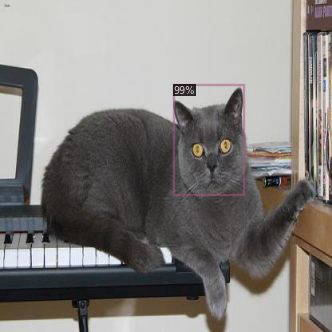

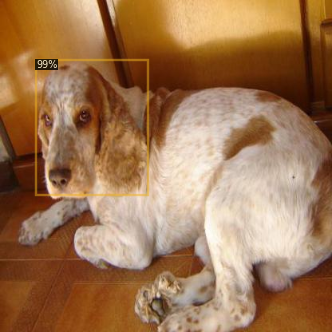

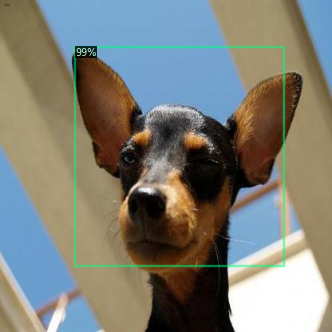

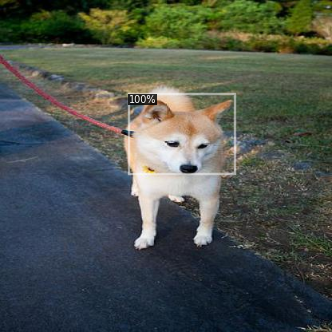

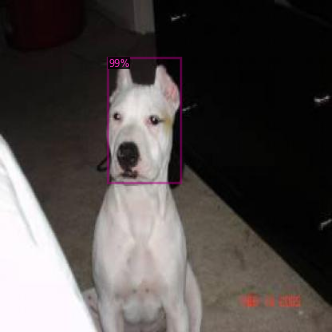

...

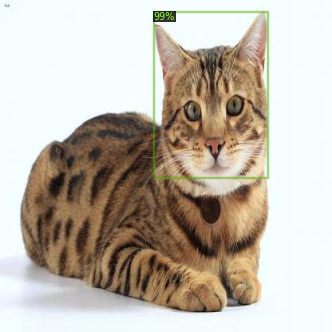

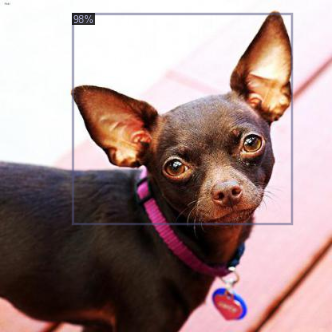

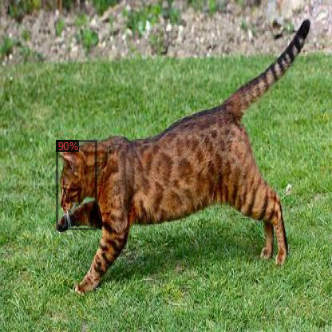

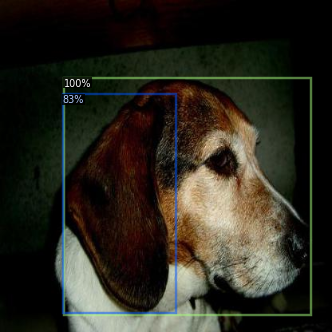

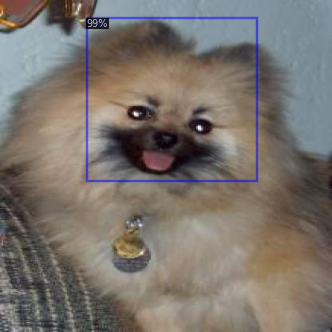


KeyboardInterrupt



In [18]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
